# Анализ данных МФЦ

## 1. Предобработка данных

In [7]:
import pandas as pd
import numpy as np
import os
from math import *
import warnings
from tqdm import tqdm

warnings.filterwarnings("ignore")

In [8]:
# Импорт вспомогательных классов
from FullPackPrediction import *
from FullPackPrediction import AnomalyDetector, Predictor

In [9]:
class Predictor(object):

    def __init__(self,
                 model=RandomForestRegressor(random_state=2),
                 add_features_table=None,
                 backward_window_size=365,
                 forward_window_size=30,
                 auto_lags=False,
                 get_features_importance=False):

        self.model = model
        self.add_features_table = add_features_table
        self.backward_window_size = backward_window_size
        self.forward_window_size = forward_window_size
        self.auto_lags = auto_lags
        self.get_features_importance = get_features_importance

    def one_pass_create_table(self, timeseries):

        data = pd.DataFrame(timeseries).copy()
        data.columns = ['y']
        
        if self.auto_lags:
            r = []
            for n in range(1, 50 + 1):
                r_current = np.corrcoef(data.y[n:], data.y.shift(n)[n:])[0, 1]
                r.append(r_current)
            all_lags = []
            b = list(zip(r, list(range(1, 51))))[:20]
            all_lags.append([x[1] for x in sorted(b, key=lambda x: np.abs(x[0]), reverse=True)[:2]])
            self._needed_lags = all_lags[0]
            for q in self._needed_lags:
                data['лаг {}'.format(q)] = data.y.shift(q)
            
        if self.add_features_table is not None:
            data = pd.concat([data, self.add_features_table], axis=1, join='inner')
        data.index = pd.to_datetime(data.index)
        data.sort_index(inplace=True)
        return data

    def one_pass_prediction(self, timeseries, test_index):

        data = self.one_pass_create_table(timeseries=timeseries)
        data = data.dropna()

        x_train = data[:test_index].drop(["y"], axis=1)
        y_train = data[:test_index]["y"]
        x_test = data[test_index:].drop(["y"], axis=1)
        y_test = data[test_index:]["y"]

        self.model.fit(x_train, y_train)
        prediction = pd.Series(self.model.predict(x_test), index=y_test.index)
        feat_imp = '-'
        if self.get_features_importance:
            feat_imp = self.model.feature_importances_
        prediction[prediction < 0] = 0

        return y_test, prediction, feat_imp

    def predict(self, timeseries):
        backward_window_size = self.backward_window_size
        forward_window_size = self.forward_window_size

        number_folds = int((len(timeseries) - backward_window_size) / forward_window_size)
        remainder = (len(timeseries) - backward_window_size) % forward_window_size
        prediction = []
        y_total = []
        features_importances=[]
        for shift in range(number_folds):
            start_index = shift * forward_window_size
            end_index = start_index + backward_window_size + forward_window_size
            y_test, pred, feat_imp = self.one_pass_prediction(timeseries[start_index:end_index], -forward_window_size)
            prediction += list(pred)
            y_total += list(y_test)
            features_importances.append(list(feat_imp))
            
        if remainder != 0:
            y_test, pred,feat_imp = self.one_pass_prediction(timeseries[-(backward_window_size + remainder):], -remainder)
            prediction += list(pred)
            y_total += list(y_test)
            features_importances.append(list(feat_imp))

        return pd.Series(y_total, index=timeseries[backward_window_size:].index), pd.Series(prediction, index=timeseries[backward_window_size:].index),features_importances

In [4]:
# Отключить отображение кода
from IPython.display  import HTML

HTML('''<script>
code_show=true;
function code_toggle() {
    if (code_show){
    $('div.input').hide();
    } else {
    $ ('div.input').show();
    }
    code_show = !code_show
    }
    $( document ).ready(code_toggle);
    </script>
    <form action="javascript:code_toggle()"><input type="submit" value="Click here to toggle on/off the raw code."></form>''')

In [10]:
# Читаем данные по всем отделениям
all_data = pd.read_csv('./data/data.csv', index_col = ['StandTime'], parse_dates = ['StandTime'], sep=';')
all_data.head()

,BID,ClientsCount,WinCount,ACWP,AUWP
StandTime,,,,,
2014-09-22 17:00:00,1,3,3,48,1
2014-09-22 18:00:00,1,3,2,49,1
2014-09-22 19:00:00,1,8,2,3,1
2014-10-03 13:00:00,1,18,2,91,3
2014-10-07 10:00:00,1,1,1,315,1


In [11]:
# Импорт библиотек рисования
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline


from plotly import __version__
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from plotly import graph_objs as go
init_notebook_mode(connected = True)

# Рисуем фрейм
def plotly_df(df, title = '', mode = ''):
    data = []
    
    for column in df.columns:
        trace = go.Scatter(
            x = df.index,
            y = df[column],
            mode = mode,
            name = column
        )
        data.append(trace)
    
    layout = dict(title = title)
    fig = dict(data = data, layout = layout)
    iplot(fig, show_link=False)
    
# Рисуем график MAE
def plot_double(pred, true, roll_days=30):
    
    mae=np.abs(true-pred).shift(1).rolling(roll_days).mean().dropna()
    with plt.style.context('seaborn-white'):
        font = {'family': 'normal','weight': 'bold'}
        plt.rc('font', **font)
        plt.figure(figsize=(17, 12))
        plt.subplots_adjust(wspace=0, hspace=0.4)
        gs = plt.GridSpec(5, 1)
        ax1 = plt.subplot(gs[:2, :])
        ax2 = plt.subplot(gs[2, :], sharex=ax1) 
        ax1.plot(pred/1e3, label='Prediction ')
        ax1.plot(true/1e3, label='Actual', color='r')
        ax2.plot(mae, color='#443f3e', label='MAE')
        ax2.set_title('MAE скользящее за {} дней '.format(roll_days), fontweight="bold")
        ax1.set_ylabel('минут')
        #    plt.fill_between(x=range(0,len(model.result)), y1=model.UpperBond, y2=model.LowerBond, alpha=0.5, color = "grey")
        ax1.legend()
        ax2.legend()
        ax1.grid(True)
        ax2.grid(True)
        plt.show()
        
# Подключаем юиюлиотеки для прогноза
from sklearn.linear_model import LinearRegression, Lasso, ElasticNet
from sklearn.svm import SVR
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import RandomForestRegressor

1


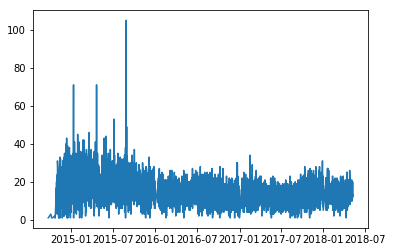

2


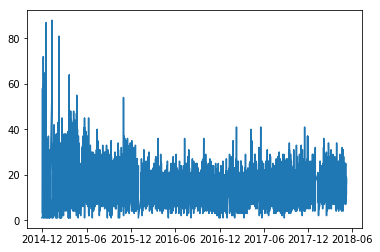

3


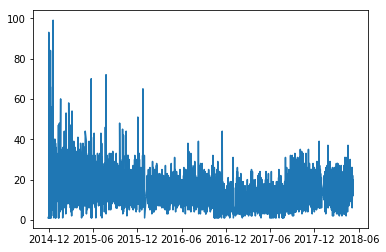

4


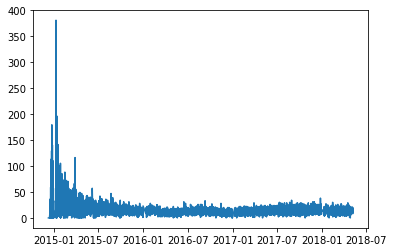

5


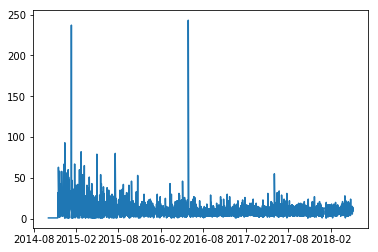

6


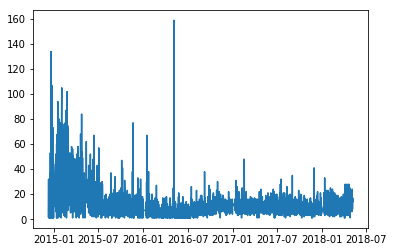

7


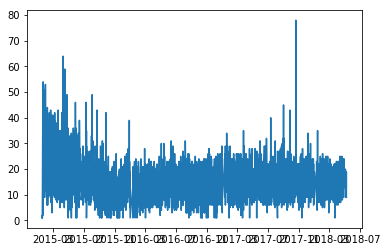

8


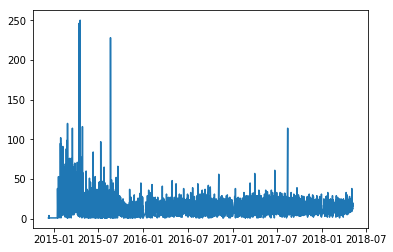

9


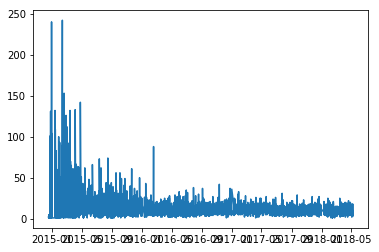

10


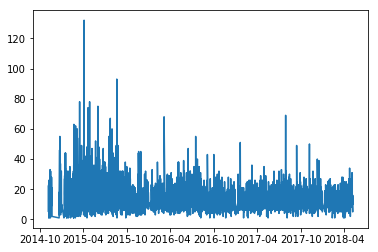

11


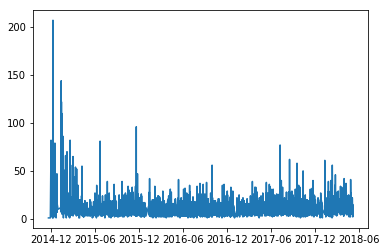

12


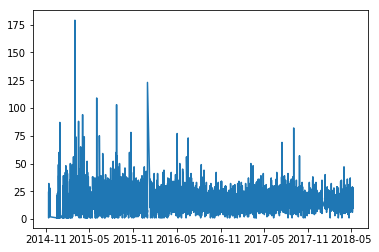

13


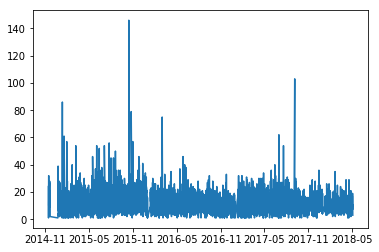

14


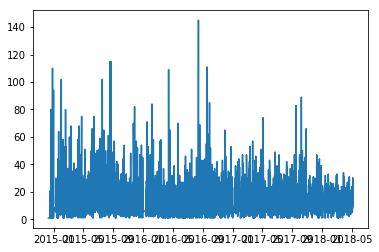

15


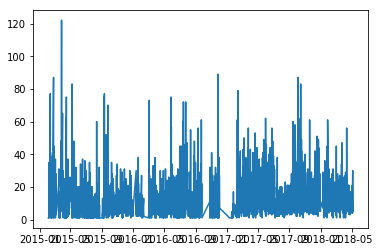

16


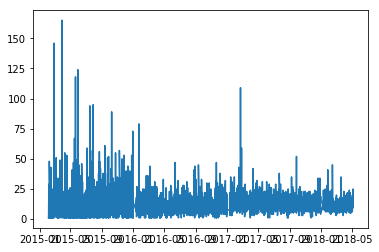

25


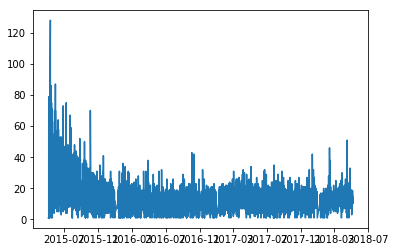

26


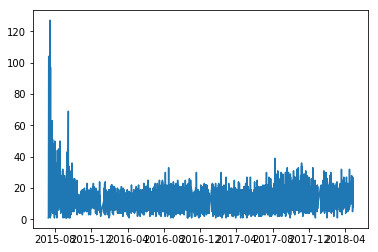

27


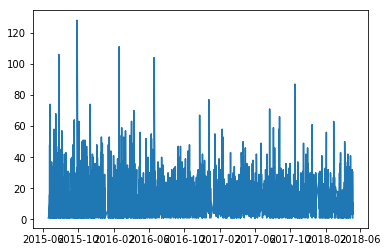

28


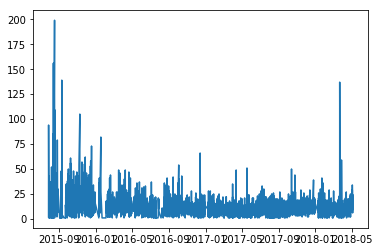

29


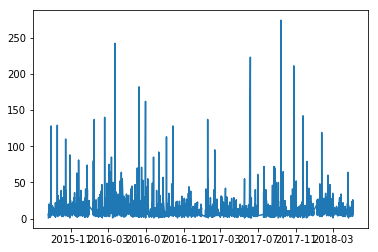

30


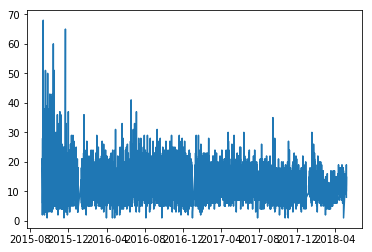

31


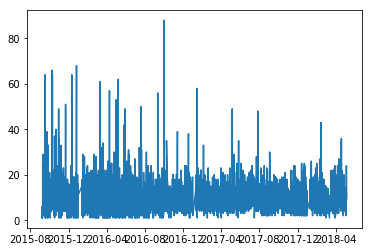

32


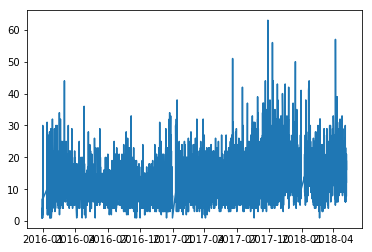

33


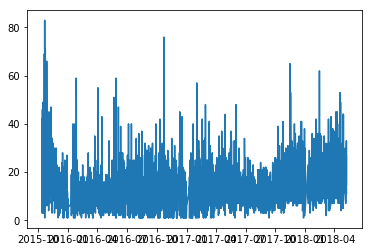

34


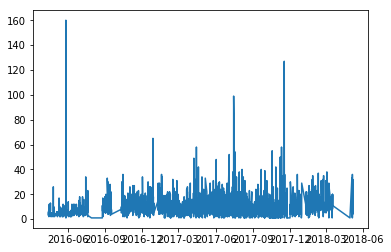

35


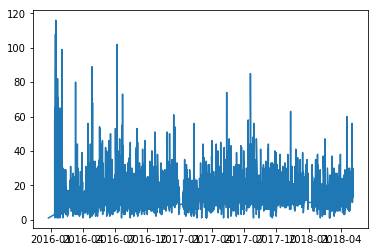

36


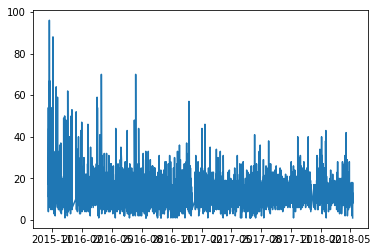

37


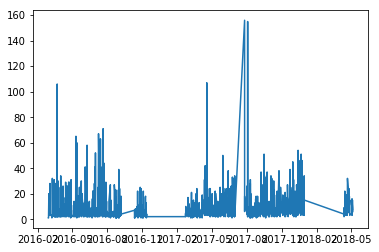

38


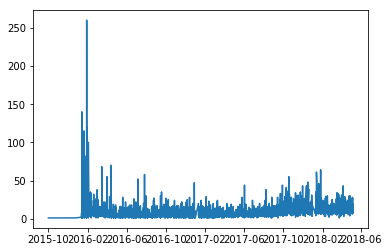

39


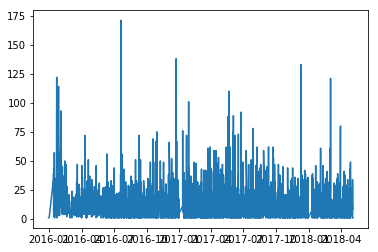

40


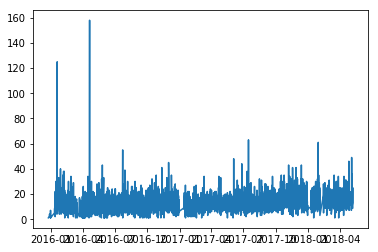

41


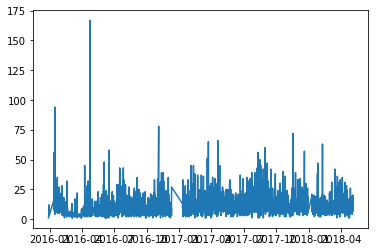

42


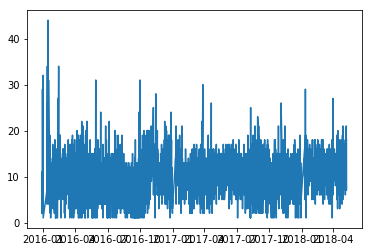

43


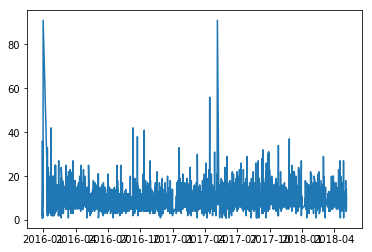

44


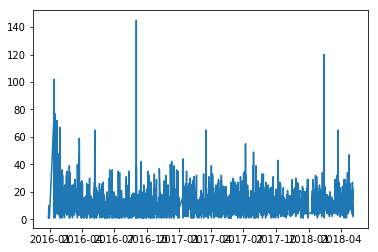

45


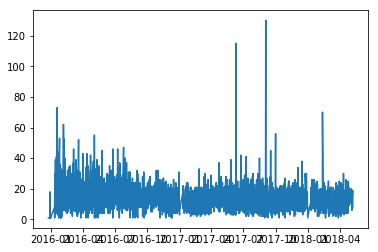

46


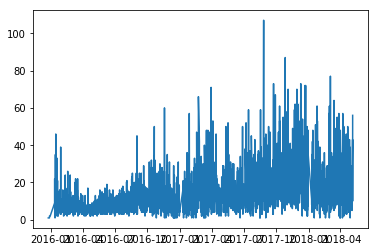

47


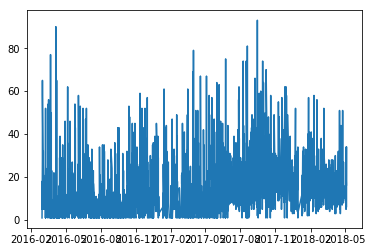

48


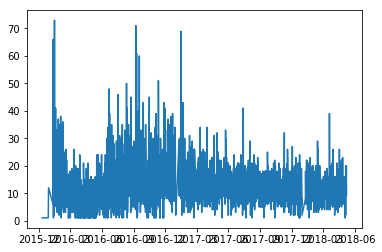

49


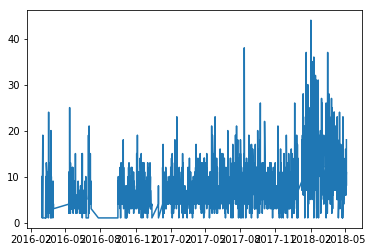

50


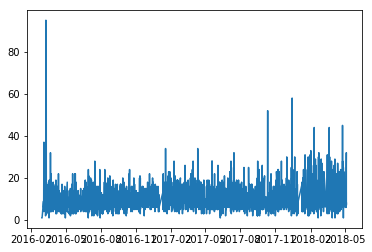

51


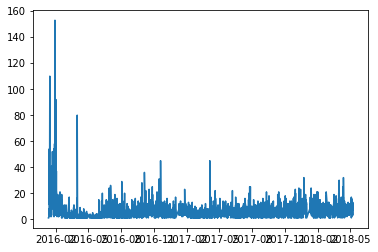

52


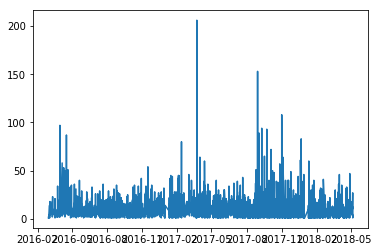

53


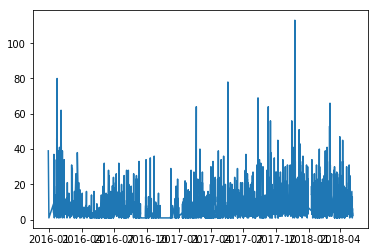

54


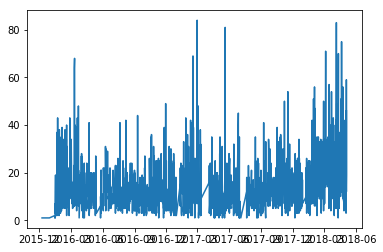

55


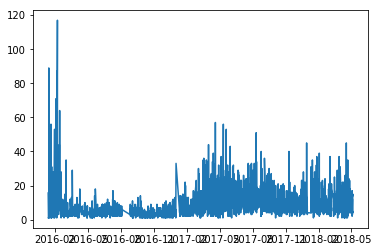

56


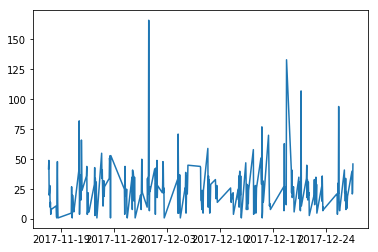

57


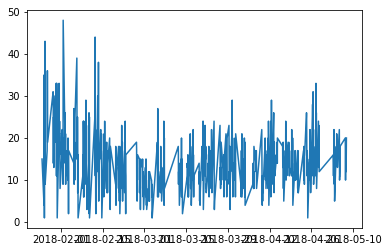

58


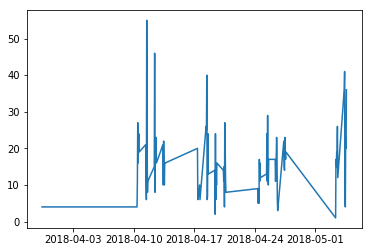

In [12]:
# Выведем информацию по всем отделениям
for bid in all_data.BID.unique():
    print(bid)
    plt.plot(all_data[all_data.BID==bid]['AUWP'])
    plt.show()

In [13]:
# Читаем данные для одного отделения
BRANCH_ID = 4 #42
branch_data = all_data[all_data.BID==BRANCH_ID]
plotly_df(branch_data, title="test", mode="lines")

In [14]:
# Заполним пропущенные значения во временном ряду
def complete_timeseries(data, column_name):
    start = data.index.min()
    end = data.index.max()
    date_range = pd.date_range(start, end, freq='H')
    date_range = pd.DataFrame(date_range)
    date_range.rename(index=str, columns={0: column_name}, inplace=True)
    date_range = date_range.join(data, on=column_name)
    date_range.fillna(0, inplace=True)
    date_range.set_index(column_name, inplace=True)
    return date_range

In [15]:
complete_branch_data = complete_timeseries(branch_data, "TimeStand")
complete_branch_data[265:270]

,BID,ClientsCount,WinCount,ACWP,AUWP
TimeStand,,,,,
2014-12-20 10:00:00,4.0,1.0,1.0,1.0,98.0
2014-12-20 11:00:00,0.0,0.0,0.0,0.0,0.0
2014-12-20 12:00:00,4.0,2.0,1.0,3.0,114.0
2014-12-20 13:00:00,0.0,0.0,0.0,0.0,0.0
2014-12-20 14:00:00,0.0,0.0,0.0,0.0,0.0


In [16]:
plotly_df(complete_branch_data, title="", mode="lines")

In [17]:
data = complete_branch_data["AUWP"]

### 1. Поиск аномальных значений (COSUM)

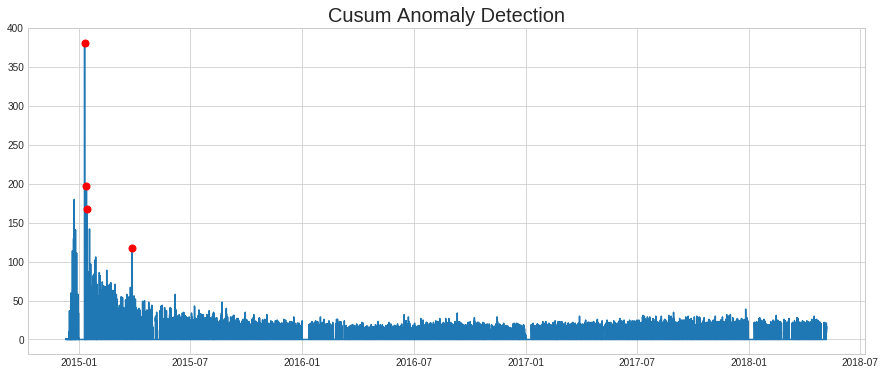

In [18]:
detector = AnomalyDetector(backward_window_size = 24*30, forward_window_size = 2)
detector.detect_and_visualize(data)

In [19]:
anomalies = detector.detect_historical(data)

In [20]:
anomalies[:10]

TimeStand
2014-12-09 09:00:00    0
2014-12-09 10:00:00    0
2014-12-09 11:00:00    0
2014-12-09 12:00:00    0
2014-12-09 13:00:00    0
2014-12-09 14:00:00    0
2014-12-09 15:00:00    0
2014-12-09 16:00:00    0
2014-12-09 17:00:00    0
2014-12-09 18:00:00    0
dtype: int64

1


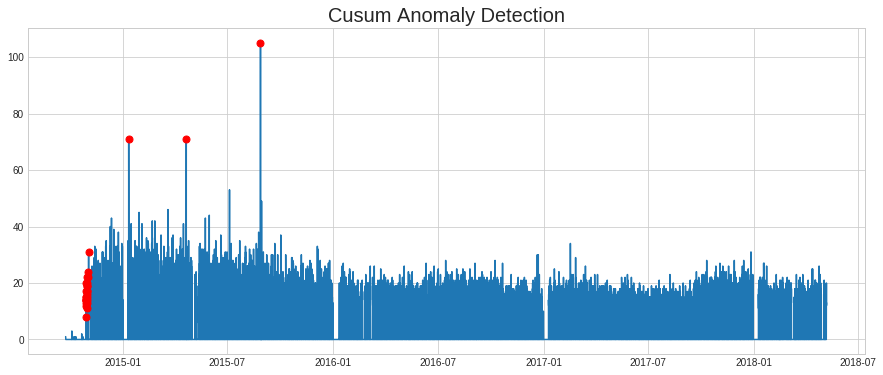

2


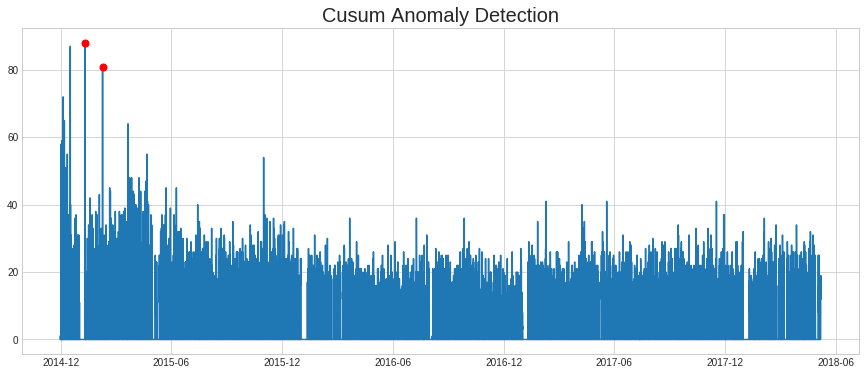

3


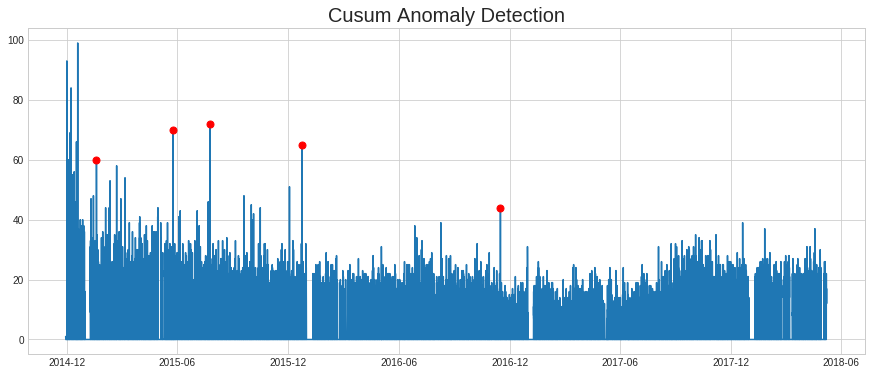

4


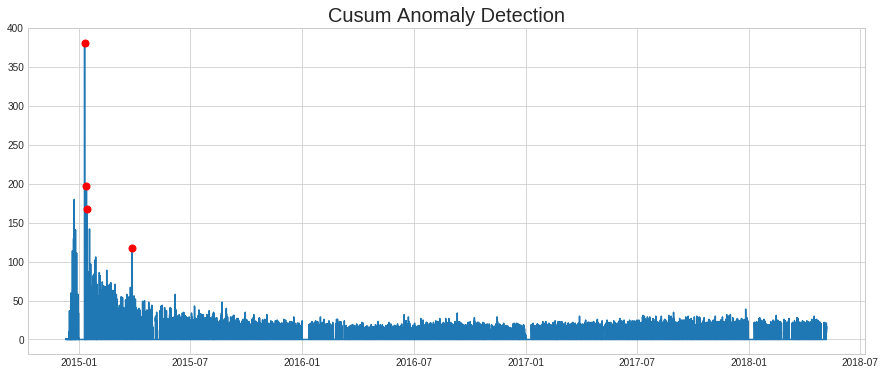

5


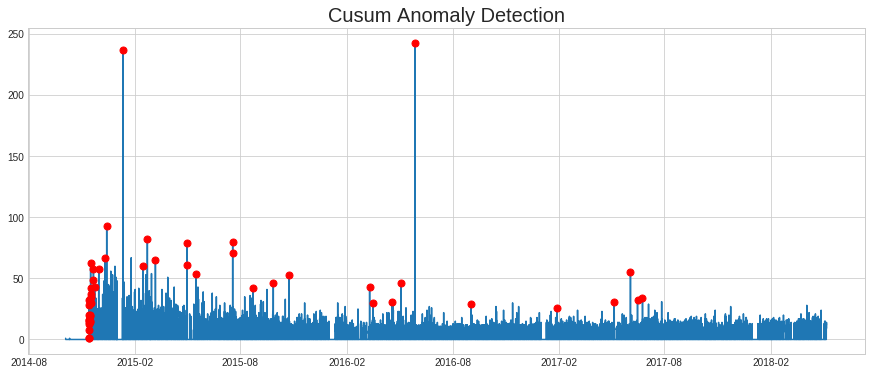

6


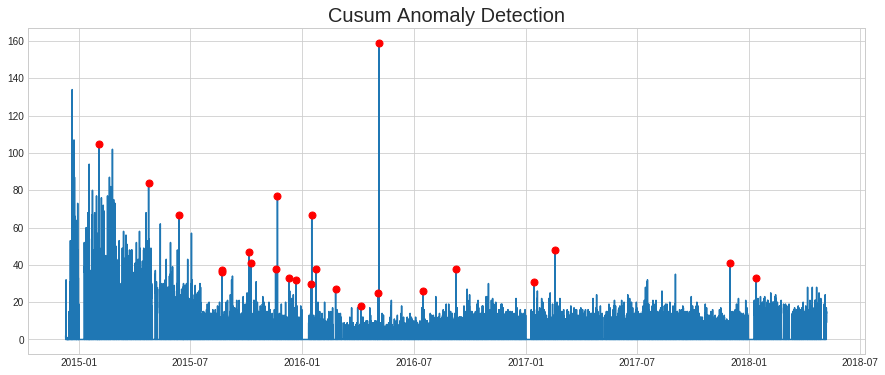

7


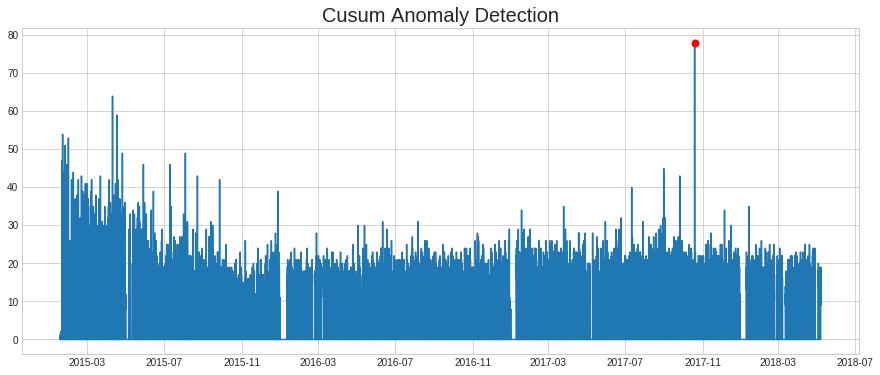

8


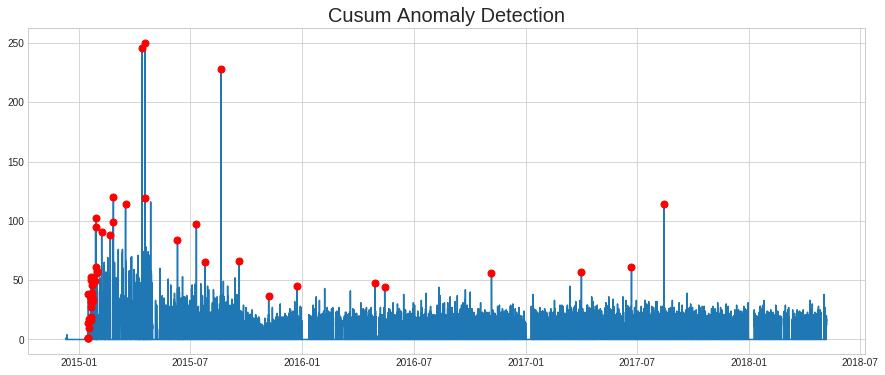

9


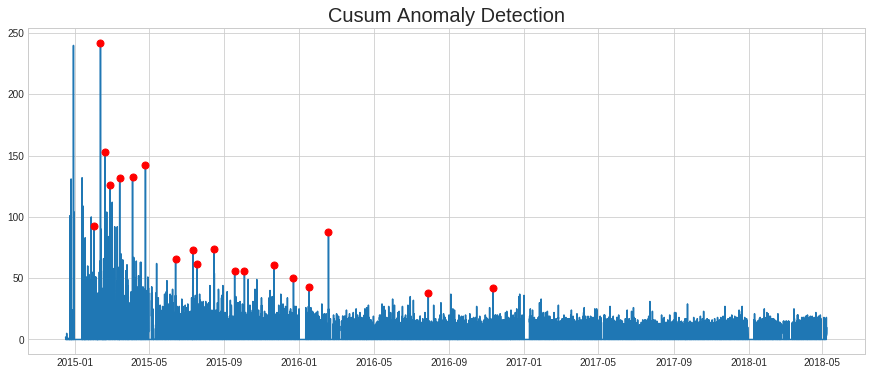

10


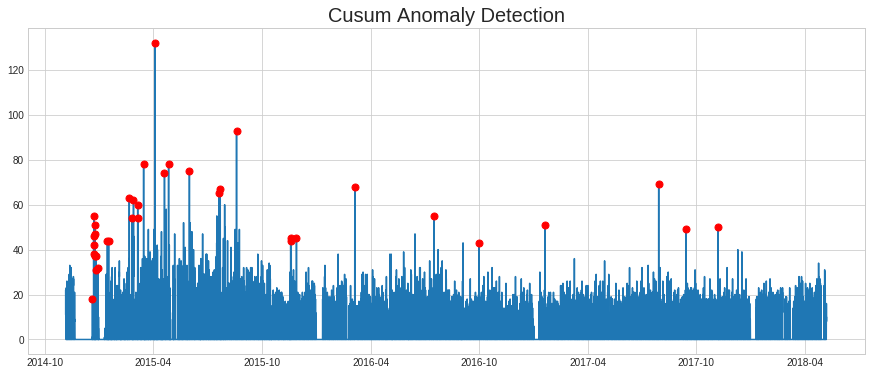

11


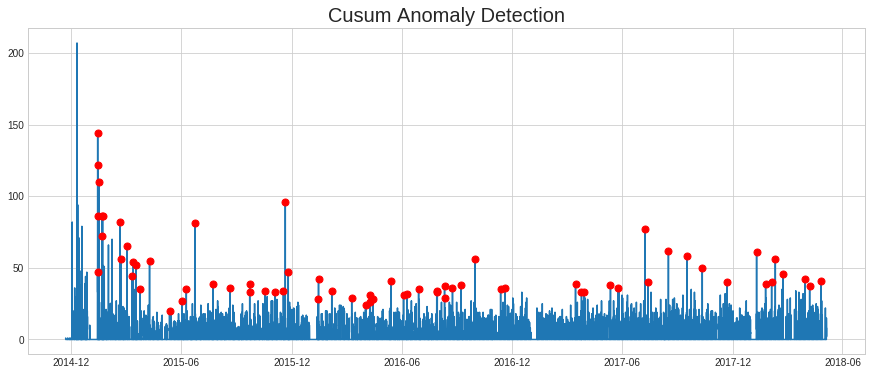

12


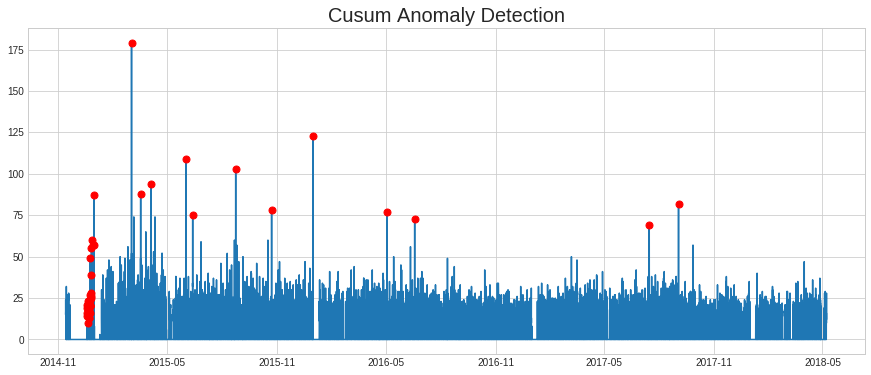

13


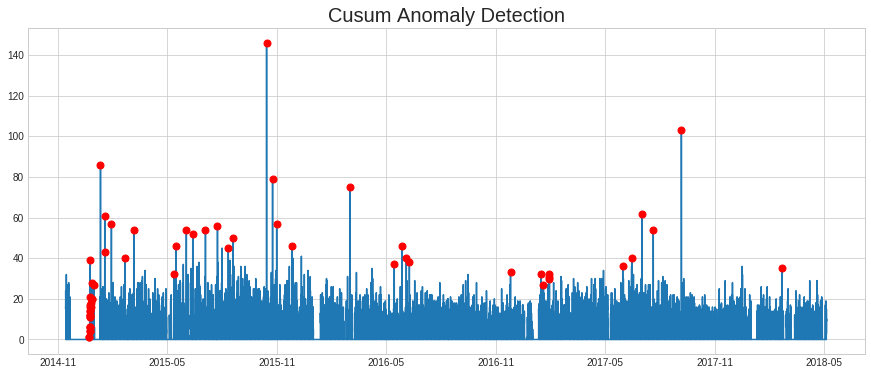

14


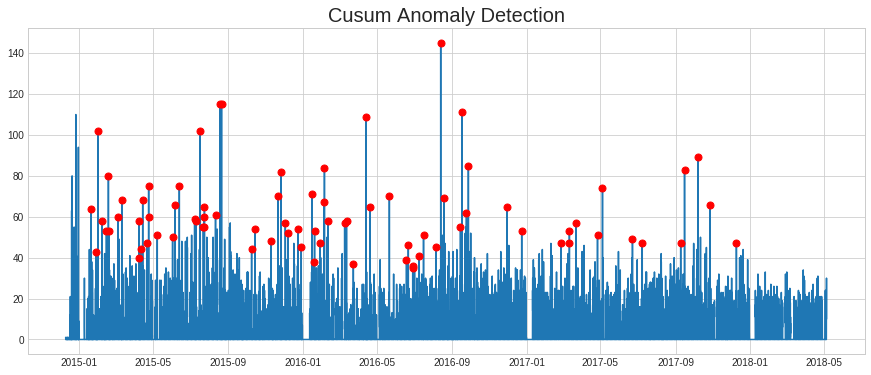

15


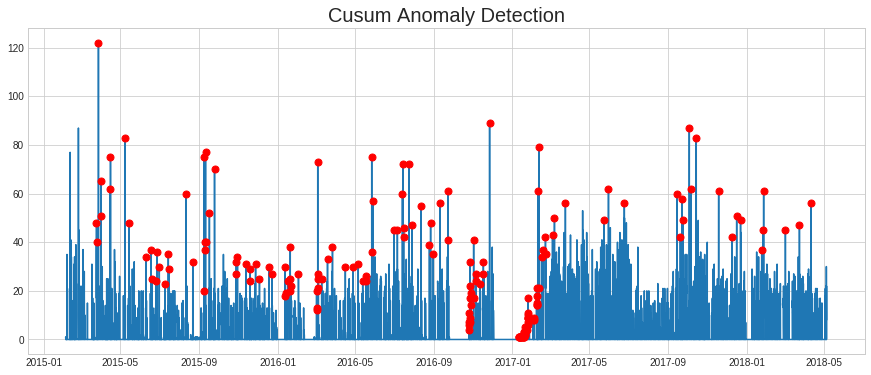

16


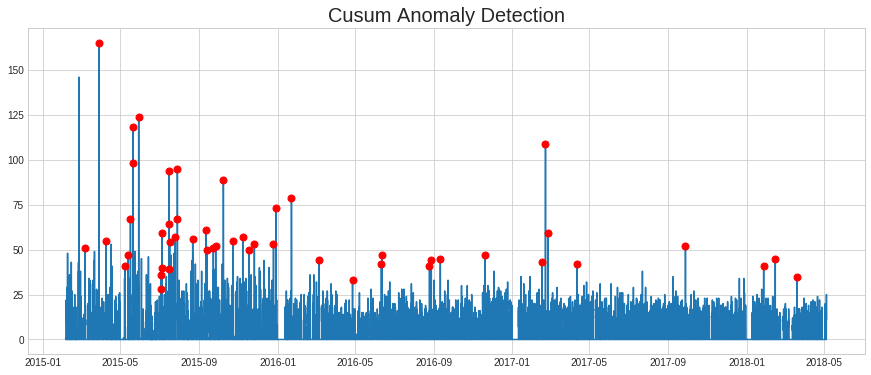

25


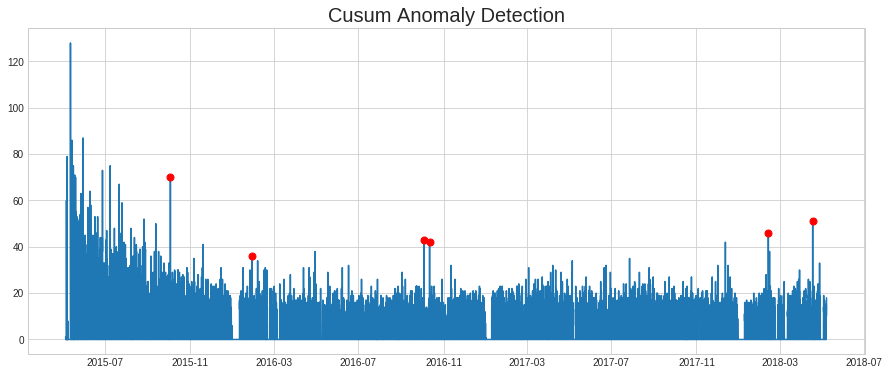

26


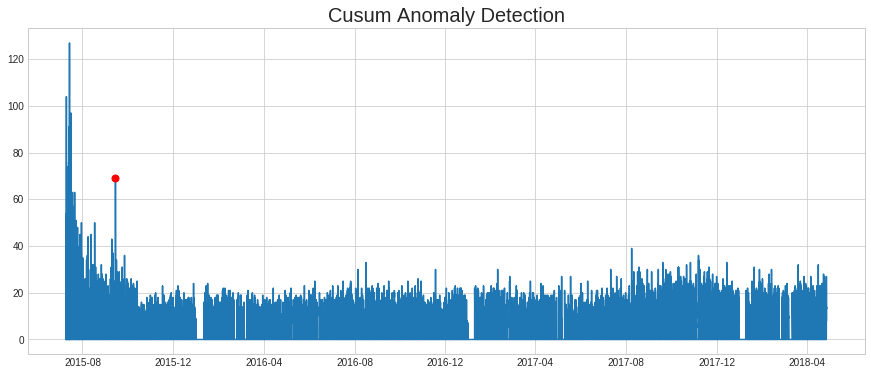

27


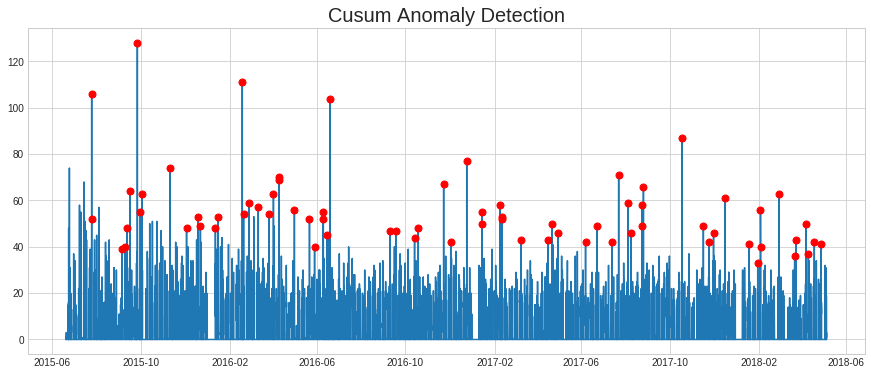

28


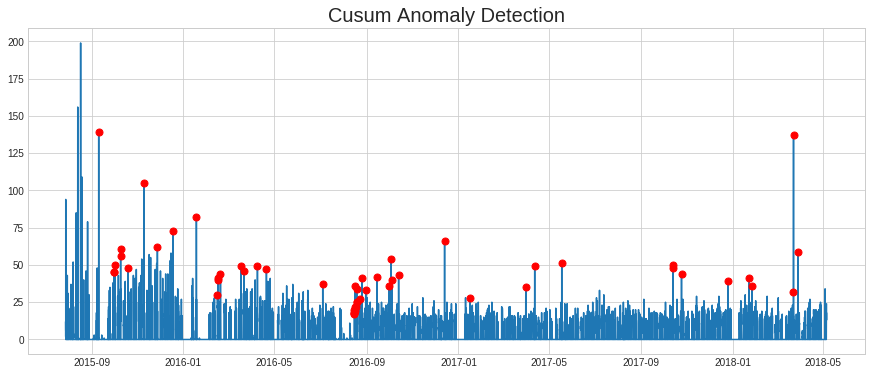

29


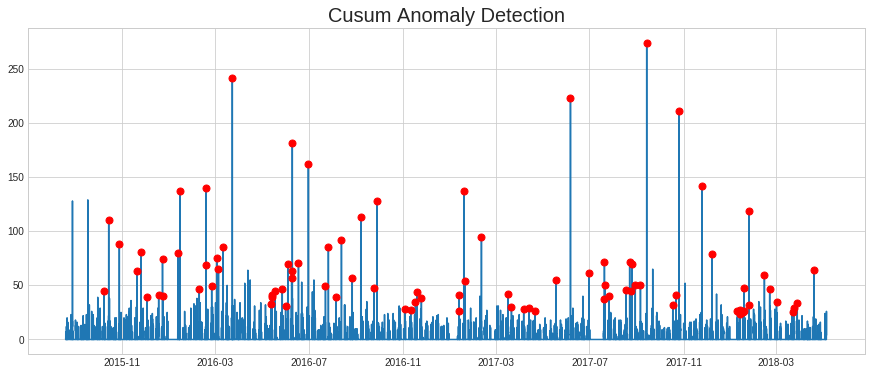

30


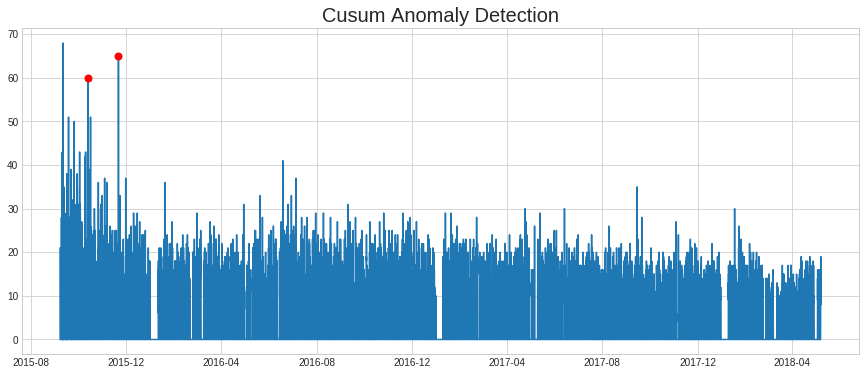

31


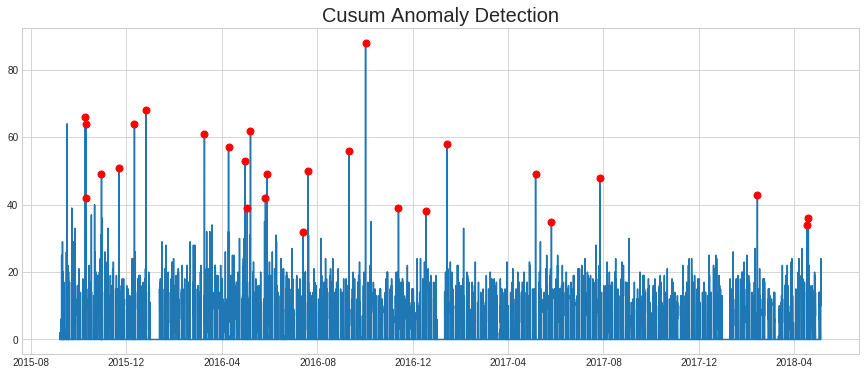

32


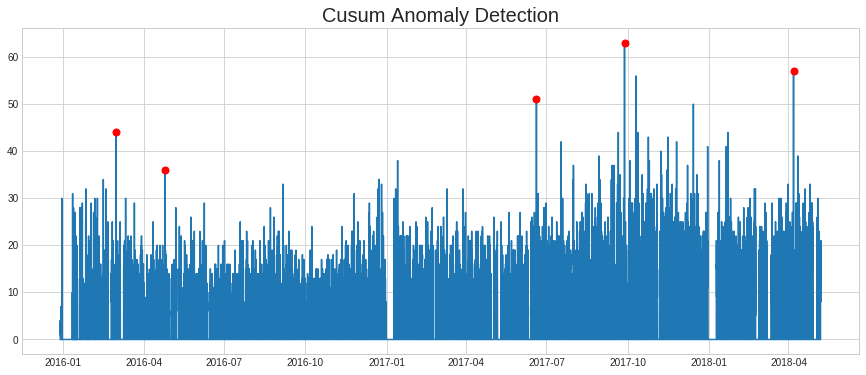

33


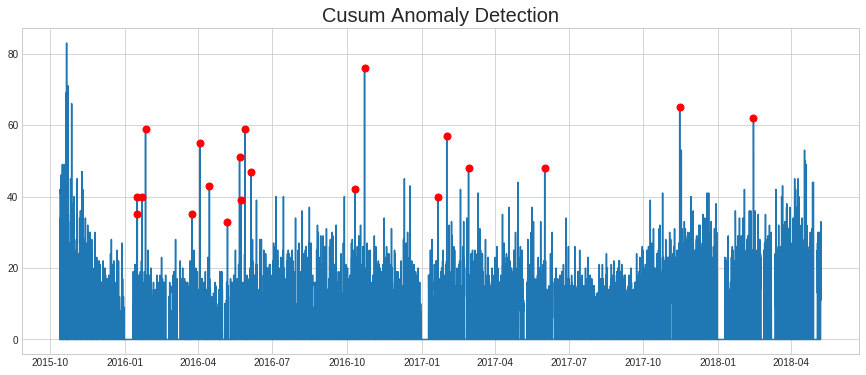

34


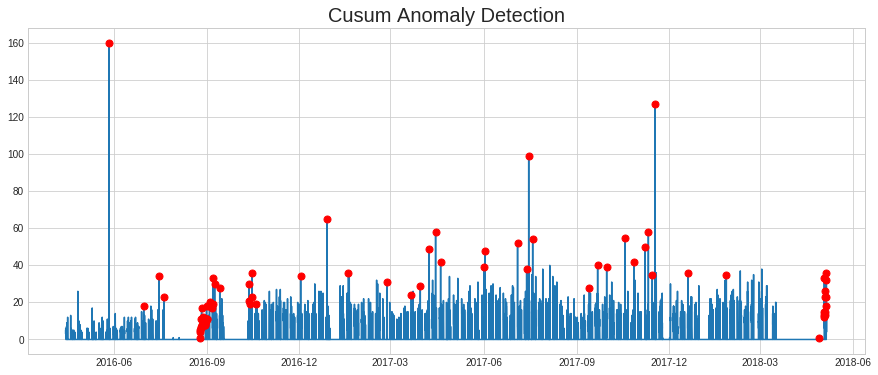

35


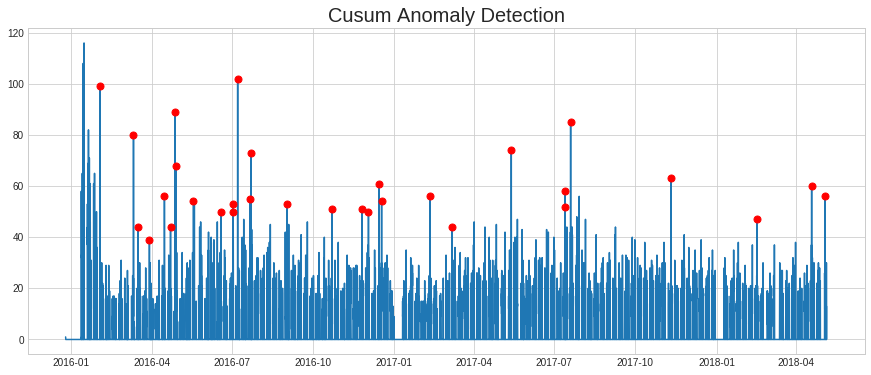

36


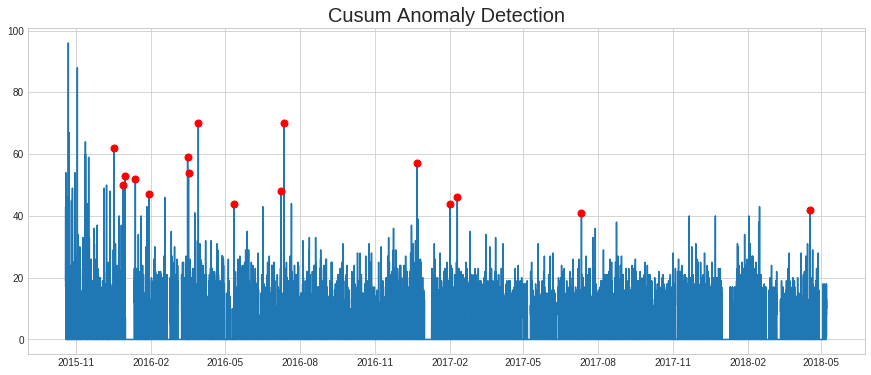

37


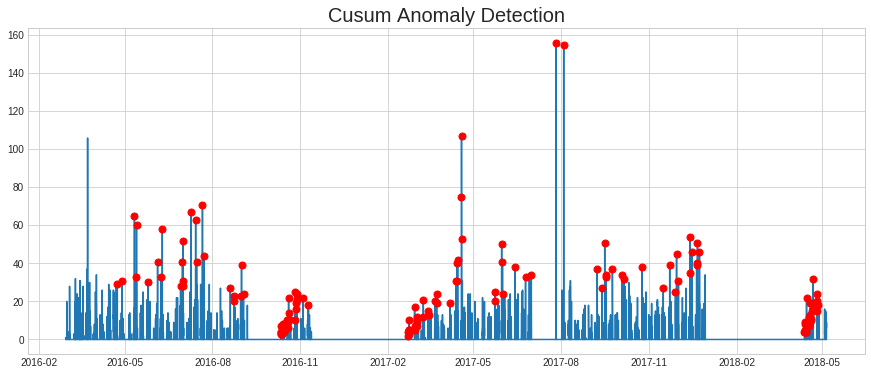

38


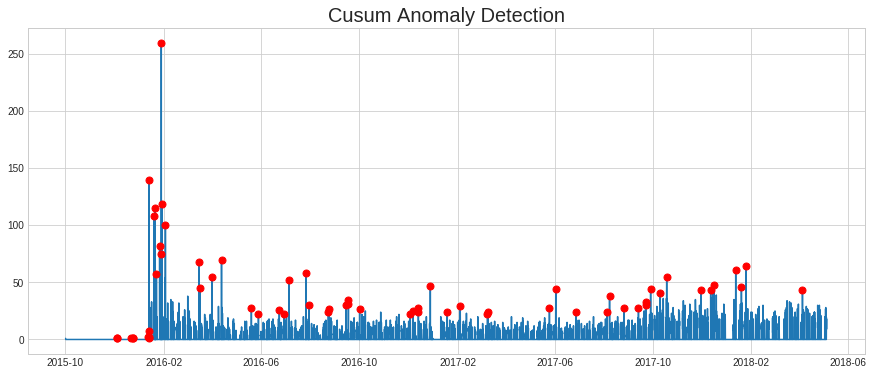

39


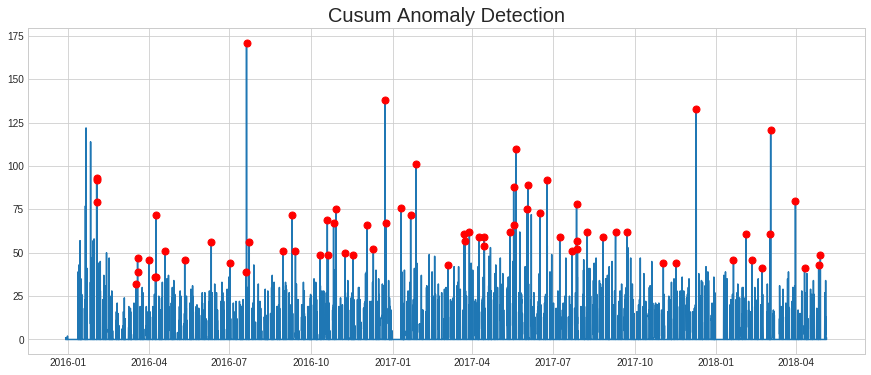

40


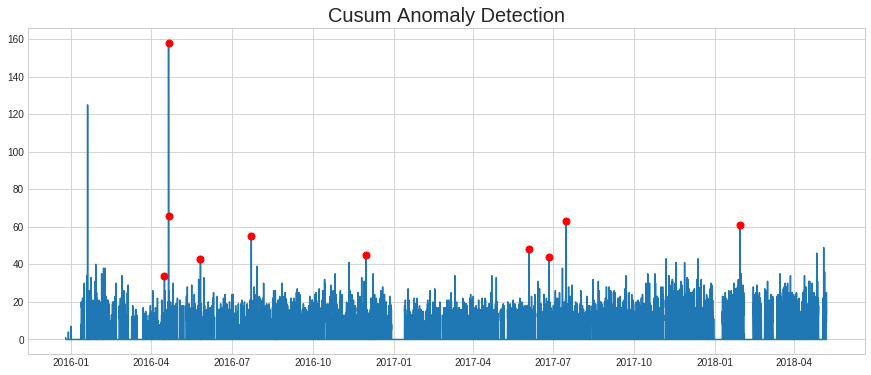

41


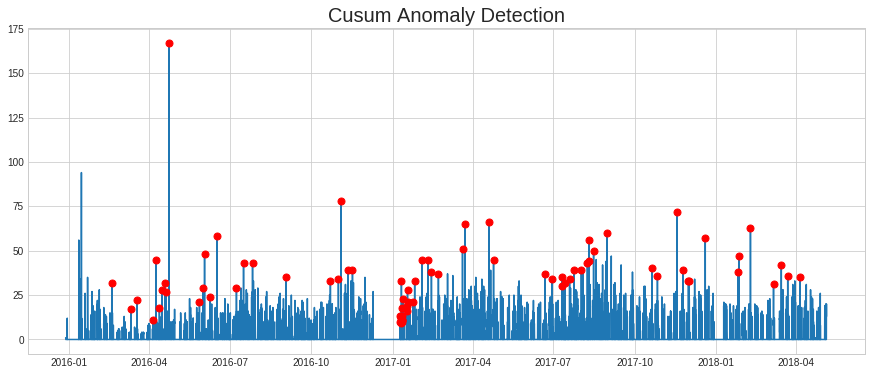

42


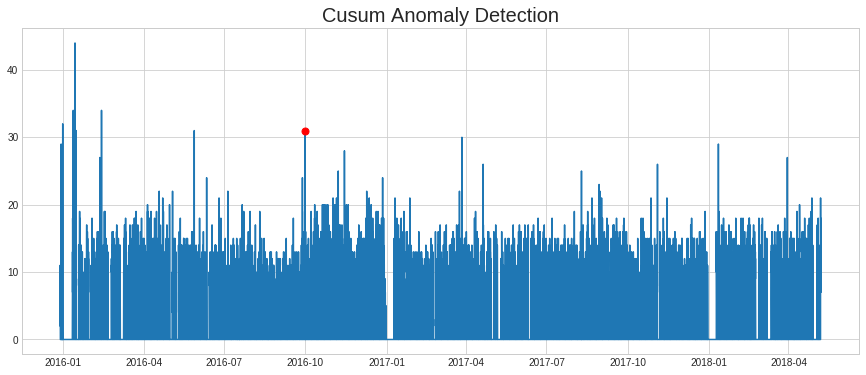

43


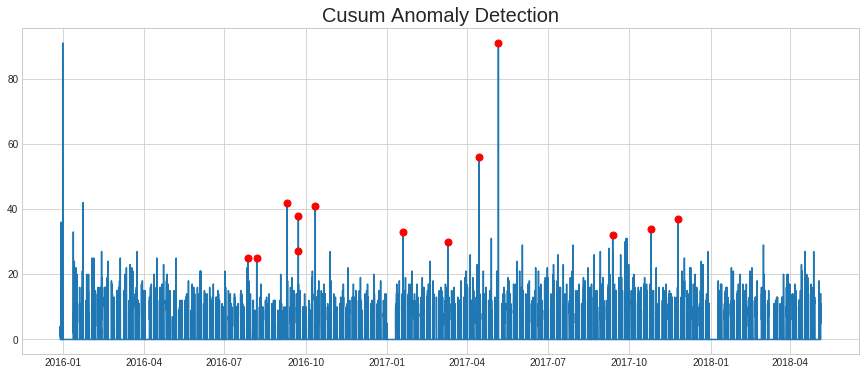

44


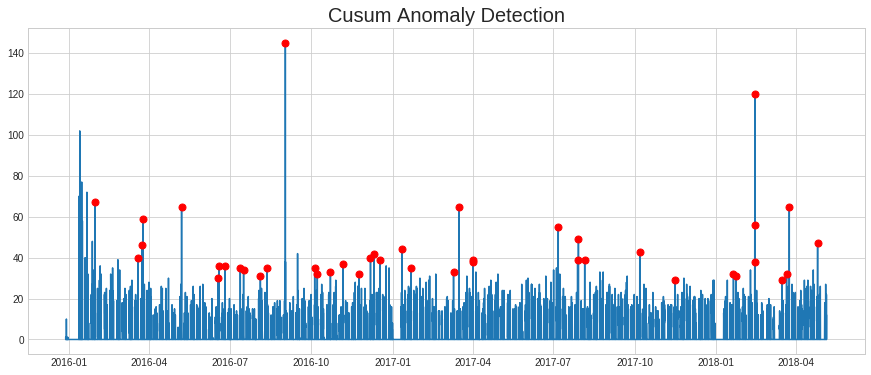

45


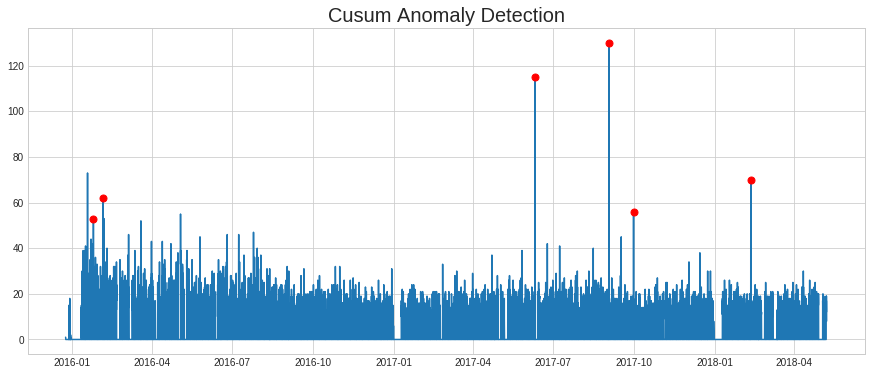

46


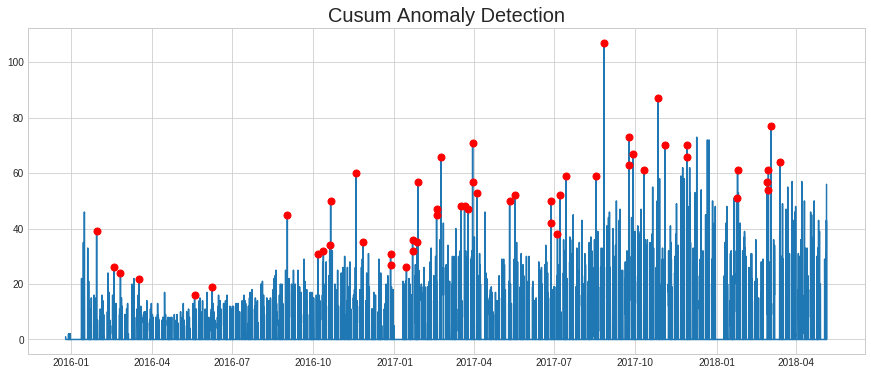

47


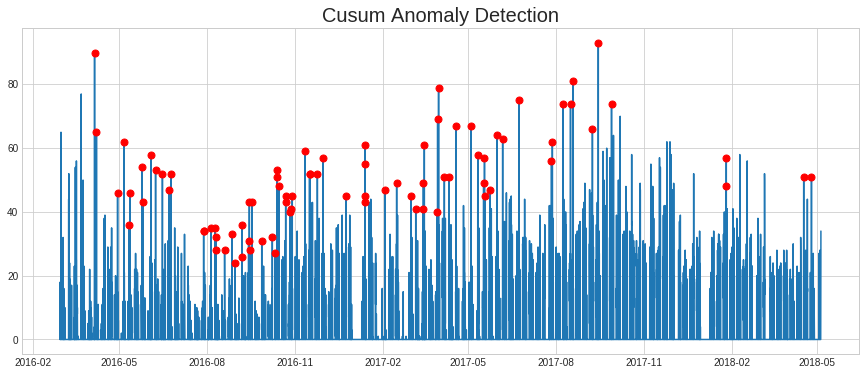

48


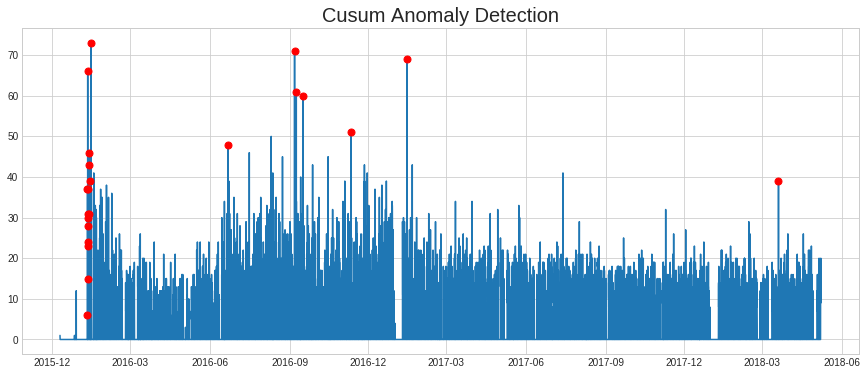

49


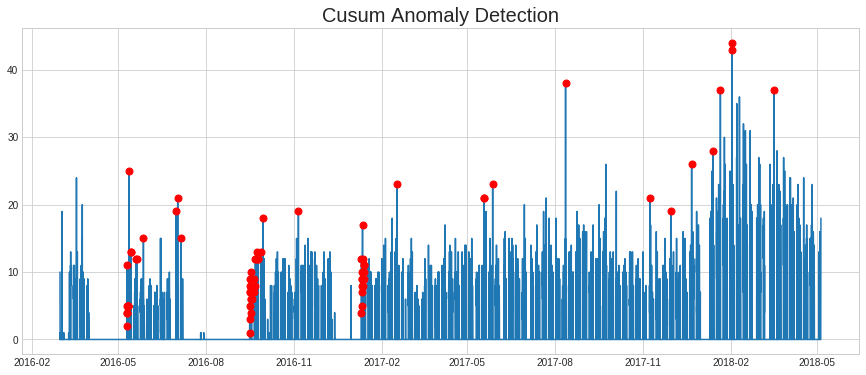

50


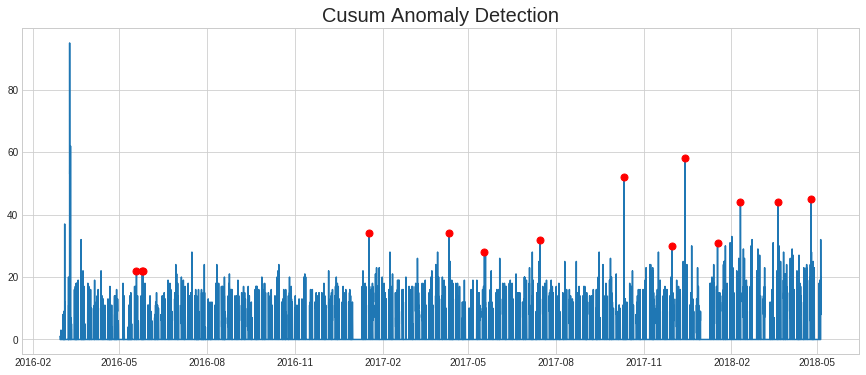

51


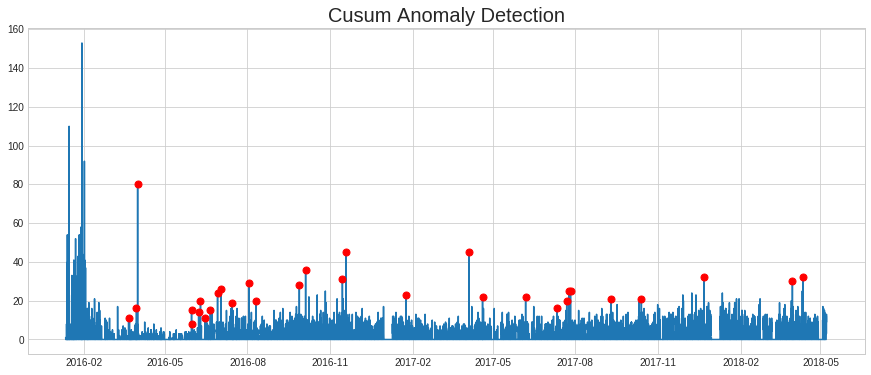

52


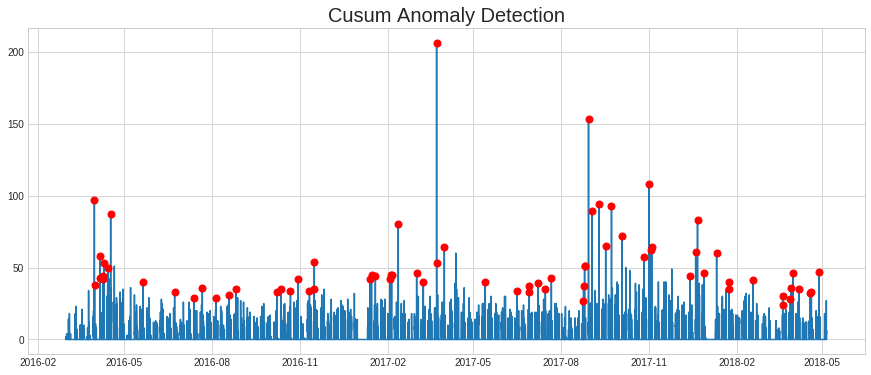

53


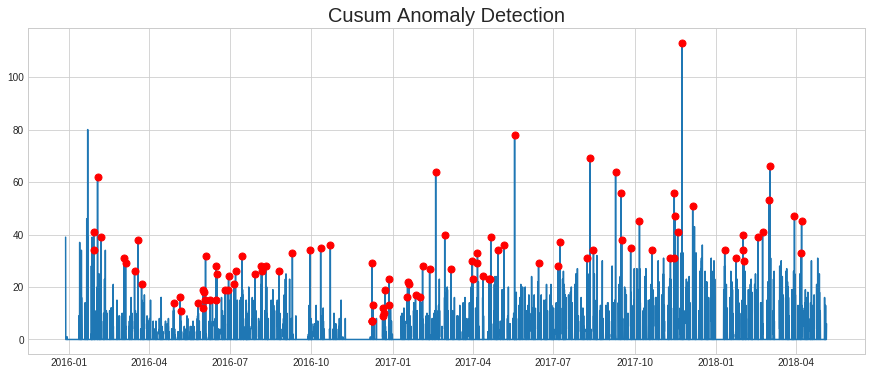

54


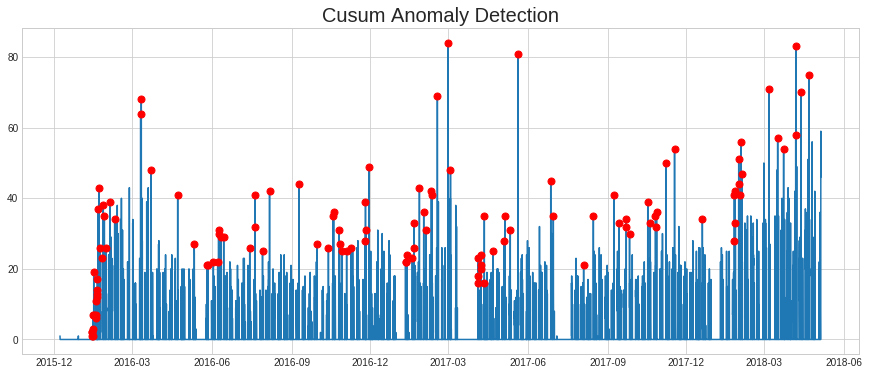

55


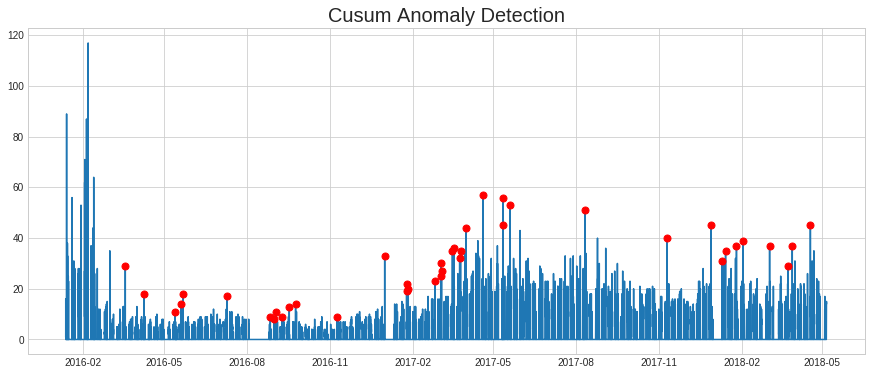

56


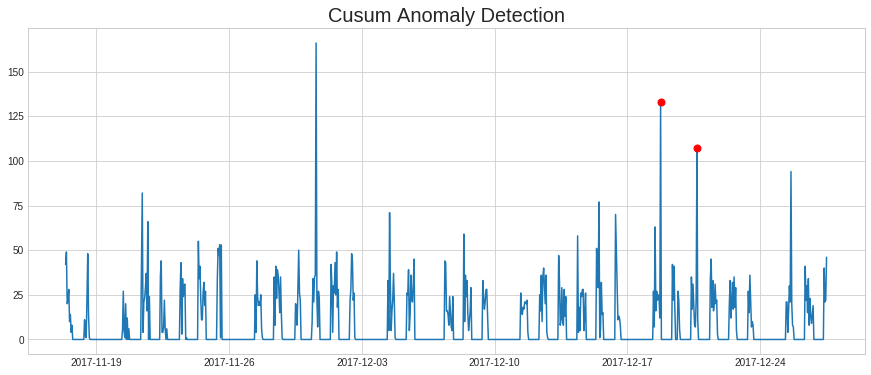

57


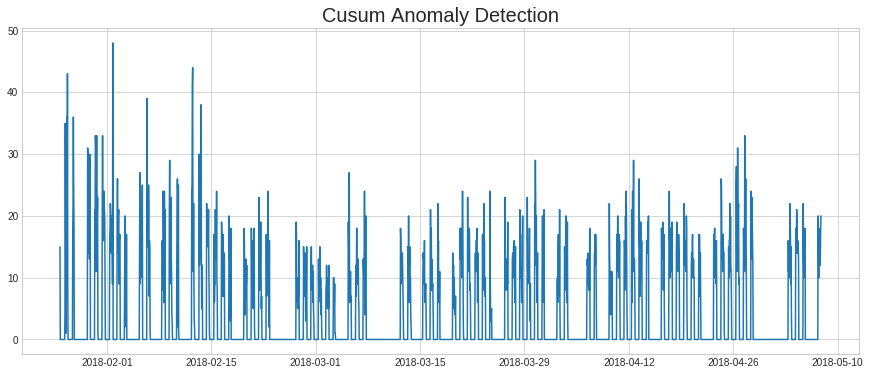

58


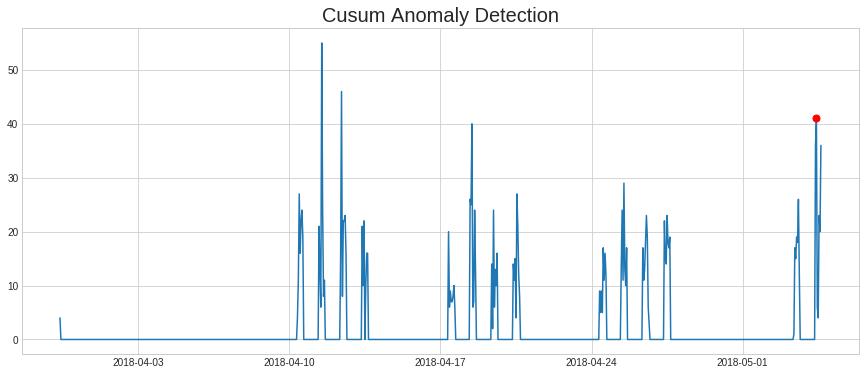

In [21]:
for bid in all_data.BID.unique():
    print(bid)
    bdata = all_data[all_data.BID==bid].loc[:, ["AUWP", "WinCount"]]
    cbdata = complete_timeseries(bdata, "TimeStand")["AUWP"]
    detector.detect_and_visualize(cbdata)

### 2. Подбор лагов
Лаги - это значения за предыдущие дни. Построим графики корреляций

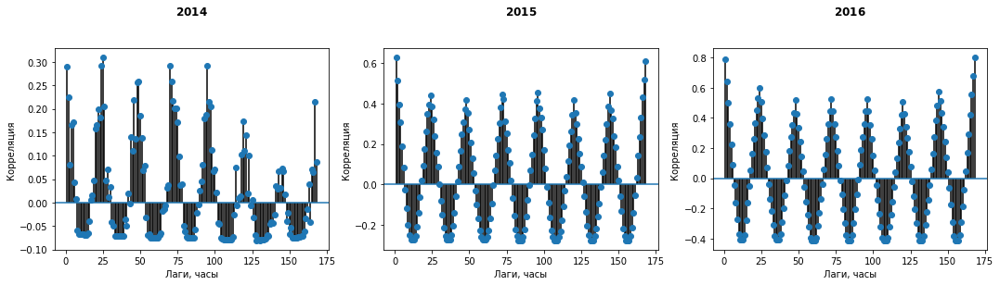

In [22]:
nlags = 24*7
dm = '-01-01'

date_range = [('2014', '2015'), 
              ('2015', '2016'), ('2016', '2017')]

fig, axs = plt.subplots(nrows=1, ncols=3, figsize=(18, 4))
axs = axs.ravel()
plt.subplots_adjust(hspace=0.4)
for j, (s,e) in enumerate(date_range):
    data_cut = data[str(s)+dm:str(e)+dm].copy()
    r = []
    for n in range(1, nlags+1):
        r_current = np.corrcoef(data_cut[n:], data_cut.shift(n)[n:])[0, 1]
        r.append(r_current)
        
    axs[j].vlines(range(1, nlags+1), [0], r)
    axs[j].axhline()
    axs[j].plot(range(1, nlags+1), r, 'o')
    axs[j].set_title(r"$\bf{" + str(s) + "}$" + "\n"*2)
    axs[j].set_xlabel('Лаги, часы')   
    axs[j].set_ylabel('Корреляция')
    
plt.show()

### 3. Анализ сезонности. Тепловая карта
Для изучение сезонности внутри каждого месяца построим heat map за каждый год (по оси X - дни месяца, по оси Y - месяца)

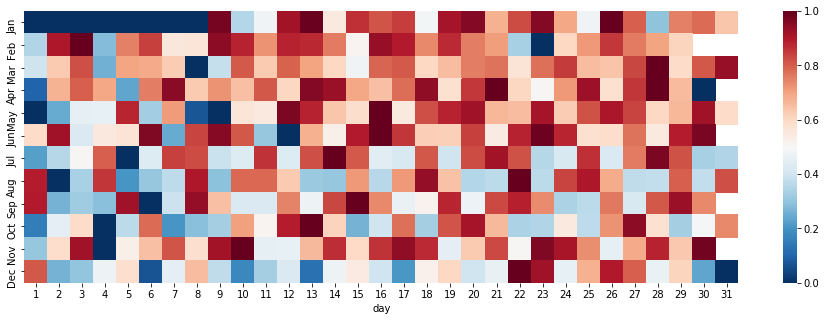

In [23]:
def minmax(x):
    q = x - np.nanmin(x)
    r = np.nanmax(x) - np.nanmin(x)
    return q / r

data_heat = data.copy()
data_heat = data_heat.rename('y')
data_heat = data_heat.groupby([data_heat.index.month, data_heat.index.day]).mean()

data_heat.index.names = ['month', 'day']
data_heat = data_heat.reset_index()

data_heat_t = data_heat.copy()
data_heat['y'] = data_heat['y'].groupby(data_heat['month']).transform(lambda x: minmax(x))
data_heat = data_heat.pivot('month', 'day')
data_heat = data_heat['y']
data_heat.index = [calendar.month_abbr[x] for x in data_heat.index]

fig, axs = plt.subplots(figsize=(16, 5))
sns.heatmap(data_heat, cmap="RdBu_r")
plt.show()


In [24]:
print(repr(data_heat.index))

Index(['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct',
       'Nov', 'Dec'],
      dtype='object')


### 4. Добавим календарные признаки
* час
* день недели
* месяц
* квартал
* выходной
* скользящие статистики (mean, std, median, max, min for 24 hour)
* праздник
* сокращенный рабочий день - добавить
* 

In [25]:
hour = pd.get_dummies(complete_branch_data.index.hour, prefix = 'hour').set_index(complete_branch_data.index)
hour[:3]

,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,...,hour_14,hour_15,hour_16,hour_17,hour_18,hour_19,hour_20,hour_21,hour_22,hour_23
TimeStand,,,,,,,,,,,,,,,,,,,,,
2014-12-09 09:00:00,0,0,0,0,0,0,0,0,0,1,...,0,0,0,0,0,0,0,0,0,0
2014-12-09 10:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2014-12-09 11:00:00,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [26]:
is_work_hour = pd.get_dummies(complete_branch_data.index.hour.isin([9,10,11,12,13,14,15,16,17,18,19,20]) * 1, prefix='is_work_hour').set_index(complete_branch_data.index)
is_work_hour[:3]

,is_work_hour_0,is_work_hour_1
TimeStand,,
2014-12-09 09:00:00,0,1
2014-12-09 10:00:00,0,1
2014-12-09 11:00:00,0,1


In [27]:
weekday = pd.get_dummies(complete_branch_data.index.weekday, prefix = 'weekday').set_index(complete_branch_data.index)
weekday[:3]

,weekday_0,weekday_1,weekday_2,weekday_3,weekday_4,weekday_5,weekday_6
TimeStand,,,,,,,
2014-12-09 09:00:00,0,1,0,0,0,0,0
2014-12-09 10:00:00,0,1,0,0,0,0,0
2014-12-09 11:00:00,0,1,0,0,0,0,0


In [28]:
month = pd.get_dummies(complete_branch_data.index.month, prefix = 'month').set_index(complete_branch_data.index)
month[:3]

,month_1,month_2,month_3,month_4,month_5,month_6,month_7,month_8,month_9,month_10,month_11,month_12
TimeStand,,,,,,,,,,,,
2014-12-09 09:00:00,0,0,0,0,0,0,0,0,0,0,0,1
2014-12-09 10:00:00,0,0,0,0,0,0,0,0,0,0,0,1
2014-12-09 11:00:00,0,0,0,0,0,0,0,0,0,0,0,1


In [29]:
quarter = pd.get_dummies(complete_branch_data.index.quarter, prefix = 'quarter').set_index(complete_branch_data.index)
quarter[:3]

,quarter_1,quarter_2,quarter_3,quarter_4
TimeStand,,,,
2014-12-09 09:00:00,0,0,0,1
2014-12-09 10:00:00,0,0,0,1
2014-12-09 11:00:00,0,0,0,1


In [30]:
is_weekend = pd.get_dummies(complete_branch_data.index.weekday.isin([5,6]) * 1, prefix='is_weekend').set_index(complete_branch_data.index)
is_weekend[:3]

,is_weekend_0,is_weekend_1
TimeStand,,
2014-12-09 09:00:00,1,0
2014-12-09 10:00:00,1,0
2014-12-09 11:00:00,1,0


In [31]:
rolling = complete_branch_data.rolling(24).agg(['mean','std','median','max','min'])
rolling.fillna(0, inplace=True)
rolling[:3]

BID                       ClientsCount                   \
                    mean  std median  max  min         mean  std median  max   
TimeStand                                                                      
2014-12-09 09:00:00  0.0  0.0    0.0  0.0  0.0          0.0  0.0    0.0  0.0   
2014-12-09 10:00:00  0.0  0.0    0.0  0.0  0.0          0.0  0.0    0.0  0.0   
2014-12-09 11:00:00  0.0  0.0    0.0  0.0  0.0          0.0  0.0    0.0  0.0   

                         ...  ACWP                       AUWP              \
                     min ...  mean  std median  max  min mean  std median   
TimeStand                ...                                                
2014-12-09 09:00:00  0.0 ...   0.0  0.0    0.0  0.0  0.0  0.0  0.0    0.0   
2014-12-09 10:00:00  0.0 ...   0.0  0.0    0.0  0.0  0.0  0.0  0.0    0.0   
2014-12-09 11:00:00  0.0 ...   0.0  0.0    0.0  0.0  0.0  0.0  0.0    0.0   

                               
                     max  min  
TimeStand                      
2014-12-09 09:00:00  0.0  0.0  
2014-12-09 10:00:00  0.0  0.0  
2014-12-09 11:00:00  0.0  0.0  

[3 rows x 25 columns]

In [32]:
features_df = pd.concat([hour, is_work_hour, weekday, is_weekend, month, quarter], axis = 1)
features_df = pd.concat([features_df, rolling, complete_branch_data["WinCount"]], axis=1)
features_df[:3]

,hour_0,hour_1,hour_2,hour_3,hour_4,hour_5,hour_6,hour_7,hour_8,hour_9,...,"(ACWP, std)","(ACWP, median)","(ACWP, max)","(ACWP, min)","(AUWP, mean)","(AUWP, std)","(AUWP, median)","(AUWP, max)","(AUWP, min)",WinCount
TimeStand,,,,,,,,,,,,,,,,,,,,,
2014-12-09 09:00:00,0,0,0,0,0,0,0,0,0,1,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
2014-12-09 10:00:00,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2014-12-09 11:00:00,0,0,0,0,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## 2. Прогноз

In [33]:
complete_branch_data[:3]

,BID,ClientsCount,WinCount,ACWP,AUWP
TimeStand,,,,,
2014-12-09 09:00:00,4.0,1.0,1.0,2.0,1.0
2014-12-09 10:00:00,0.0,0.0,0.0,0.0,0.0
2014-12-09 11:00:00,0.0,0.0,0.0,0.0,0.0


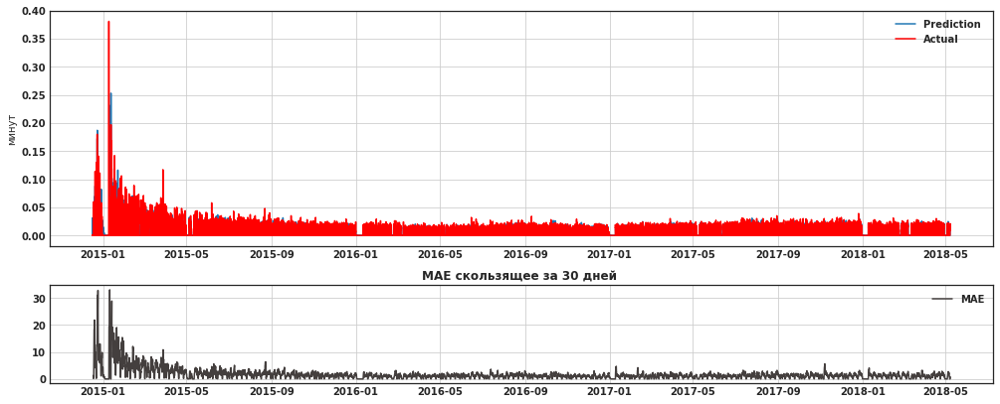

In [34]:
model_predictions = dict()
pred = Predictor(model=GradientBoostingRegressor(random_state=2),backward_window_size=7*24,\
              forward_window_size=9,add_features_table=features_df,auto_lags=False)
y, yhat,_ = pred.predict(timeseries=complete_branch_data["AUWP"])
results = pd.DataFrame({'факт': y, 'прогноз':yhat})
plot_double(results['прогноз'], results['факт'])
model_predictions['GB']=results

In [35]:
mae = round(np.nanmean(np.abs(results['факт'] - results['прогноз'])), 2)
print("MAE : {}".format(mae))

MAE : 1.66


In [36]:
plotly_df(results, title="Результат предсказания", mode="lines")

In [37]:
feat_names=sum([[],list(features_df.columns)],[])

In [ ]:
pred = Predictor(model=GradientBoostingRegressor(random_state=42),backward_window_size=24*7,\
              forward_window_size=5,add_features_table=features_df,auto_lags=True,get_features_importance=True)
y, yhat, feat_importances = pred.predict(timeseries=complete_branch_data["AUWP"])

In [ ]:
plt.figure(figsize=(17,6))
pos=np.arange(len(np.array(feat_importances).mean(axis=0)))
plt.bar(pos,np.array(feat_importances).mean(axis=0),alpha=0.5)
plt.xticks(pos,feat_names,rotation=60)
plt.show()